# Optimizing College Cooking

**Name(s)**: Samuel Eun

**Website Link**: samuelsilver.me/optimizing_college_meals

In [2]:
import pandas as pd
import numpy as np
from pathlib import Path

import plotly.express as px
pd.options.plotting.backend = 'plotly'

from dsc80_utils import * # Feel free to uncomment and use this.

## Step 1: Introduction

* I am using the Recipes and Ratings data set
    * What is the effort/time to nutrition/rating of meals?
        * What are some key features of lower effort to value meals?
        * Can I define a new value that gauges effort/difficulty in terms of minutes and n_steps?
        * Can I define a new value that gauges value in terms of rating and nutrition?
    * Can I incorporate a recipe search feature into the website? - kinda unrelated
   
I will be investigating the first question: ***What meals are the easiest, tastiest, and healthiest  - AKA what recipes are worth it?***

## Step 2: Data Cleaning and Exploratory Data Analysis

In [3]:
recipes = pd.read_csv('food_data/RAW_recipes.csv')
ratings = pd.read_csv('food_data/RAW_interactions.csv')


### Merging Dataset Per Instructions

In [4]:
# left merge datasets
recipes_n_ratings = recipes.merge(ratings, how='left', left_on='id', right_on='recipe_id')
# drop duplicate column
recipes_n_ratings = recipes_n_ratings.drop(columns='recipe_id')
# replace 0 with np.nan in rating column
recipes_n_ratings['rating'] = recipes_n_ratings['rating'].apply(lambda x: np.nan if x == 0 else x)

# calculate avg_rating column
avg_rating = (
    recipes_n_ratings[['id', 'rating']]
    .groupby('id')
    .mean()
    .reset_index()
    .rename(columns=({'rating': 'avg_rating'}))
)
# add avg_rating column
recipes_n_ratings = recipes_n_ratings.merge(avg_rating, on='id')

recipes_n_ratings

,name,id,minutes,contributor_id,...,date,rating,review,avg_rating
0,1 brownies in the world best ever,333281,40,985201,...,2008-11-19,4.0,"These were pretty good, but took forever to ba...",4.0
1,1 in canada chocolate chip cookies,453467,45,1848091,...,2012-01-26,5.0,Originally I was gonna cut the recipe in half ...,5.0
2,412 broccoli casserole,306168,40,50969,...,2008-12-31,5.0,This was one of the best broccoli casseroles t...,5.0
...,...,...,...,...,...,...,...,...,...
234426,cookies by design sugar shortbread cookies,298509,20,506822,...,2008-06-19,1.0,This recipe tastes nothing like the Cookies by...,3.0
234427,cookies by design sugar shortbread cookies,298509,20,506822,...,2010-02-08,5.0,"yummy cookies, i love this recipe me and my sm...",3.0
234428,cookies by design sugar shortbread cookies,298509,20,506822,...,2014-11-01,NaN,I work at a Cookies By Design and can say this...,3.0


### Adding Nutritional Columns

Information in dictionary below taken from: https://www.fda.gov/food/nutrition-facts-label/daily-value-nutrition-and-supplement-facts-labels <br> 
Units in `DV` is in grams

In [5]:
DV = {
    'total fat': 78,
    'sugar': 50,
    'sodium': 2.3,
    'protein': 50,
    'saturated fat': 20,
    'carbohydrates': 275
}

`n` is the column nutrition from recipes_n_ratings in form: <br> **[calories, total fat, sugar, sodium, protein, saturated fat, and carbohydrates]**, <br> where every value after calories is in %DV.

In [6]:
n = recipes_n_ratings['nutrition'].apply(lambda x: x.strip('[]').split(','))

`Macros` is a DataFrame of columns split from `n` into each macronutrtional value, in grams

In [7]:
# initialize macros DataFrame that holds each marco starting with calories
macros = pd.DataFrame().assign(calories=n.apply(lambda x: float(x[0])))
# initialize a list that will hold Series that will be the columns of macros after calories
m_cols = []

# fill m_cols with Series of each macro in n converted to grams from DV
for i in range(len(list(DV.keys()))):
    m_cols.append(
        pd.Series(
            n.apply(lambda x: (float(x[1:][i])/100)*DV[list(DV.keys())[i]]), name=list(DV.keys())[i]
        )
    )
# add each Series into the macros DataFrame as a column
for i in range(len(m_cols)):
    macros[m_cols[i].name] = m_cols[i]

macros

,calories,total fat,sugar,sodium,protein,saturated fat,carbohydrates
0,138.4,7.80,25.0,0.07,1.5,3.8,16.50
1,595.1,35.88,105.5,0.51,6.5,10.2,71.50
2,194.8,15.60,3.0,0.74,11.0,7.2,8.25
...,...,...,...,...,...,...,...
234426,174.9,10.92,16.5,0.09,2.0,2.2,16.50
234427,174.9,10.92,16.5,0.09,2.0,2.2,16.50
234428,174.9,10.92,16.5,0.09,2.0,2.2,16.50


`rnr` is a new DataFrame `recipes_n_ratings` joined with `macros`

In [8]:
# recipes_n_ratings DataFrame without unessesary columns and added macros
rnr = recipes_n_ratings.join(macros)
rnr

,name,id,minutes,contributor_id,...,sodium,protein,saturated fat,carbohydrates
0,1 brownies in the world best ever,333281,40,985201,...,0.07,1.5,3.8,16.50
1,1 in canada chocolate chip cookies,453467,45,1848091,...,0.51,6.5,10.2,71.50
2,412 broccoli casserole,306168,40,50969,...,0.74,11.0,7.2,8.25
...,...,...,...,...,...,...,...,...,...
234426,cookies by design sugar shortbread cookies,298509,20,506822,...,0.09,2.0,2.2,16.50
234427,cookies by design sugar shortbread cookies,298509,20,506822,...,0.09,2.0,2.2,16.50
234428,cookies by design sugar shortbread cookies,298509,20,506822,...,0.09,2.0,2.2,16.50


#### Filtering Duplicates
For the following exploratory analysis, I will be focusing on unique recipes. In `recipes_n_ratings` and `rnr`, there are duplicate recipes based on how many reviews each recipe has. I want to eliminate those duplicates and focus on the aggregated `avg_rating` value. <br>
<br> 
`rnr_unique` will be a DataFrame of these unique recipes, dropping duplicates after the first unique recipe appearance.

In [9]:
rnr_unique = rnr.drop_duplicates(subset=['id'])

## Step 2 - Univariate Analysis

#### Number of Recipes for Calories
`count_calories` is a DataFrame with columns `calories`, which corresponds to the calories of each unique recipe, and `count`, which corresponds to the count of unique recipes for each calories

In [10]:
# getting the count of recipes for each calories
count_calories = rnr_unique[['calories']].assign(count=[0]*rnr_unique.shape[0])
count_calories = count_calories.groupby('calories').count().reset_index()
# limiting range to exclude outliers
count_calories = count_calories[count_calories['calories'] <= 1600]

px.scatter(
    count_calories, 
    x='calories', 
    y='count', 
    title='Number of Recipes for Calories',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='lowess',
    trendline_options=dict(frac=0.15),
    trendline_color_override='blue'
)

#### Number of Recipes for Steps
`count_steps` is a DataFrame with columns `n_steps`, which corresponds to each unique number of steps, and `count`, which corresponds to the count of unique recipes for each number of steps

In [11]:
# getting the count of recipes for each number of steps
count_steps = rnr_unique[['n_steps']].assign(count=[0]*rnr_unique.shape[0])
count_steps = count_steps.groupby('n_steps').count().reset_index()
# limiting range to exclude outliers
count_steps = count_steps[count_steps['n_steps'] <= 50]

px.line(
    count_steps,
    x='n_steps',
    y='count',
    title='Number of Recipes by Steps'
)

#### Examining the Distribution of Minutes

In [12]:
px.box(rnr_unique, 'minutes', title='Distribution of Minutes', height=250, width=500)

As you can see, `minutes` is a column with data that is heavily skewed. Let's look into it.

In [13]:
print(f'Total Number of Recipes: {rnr_unique.shape[0]} \n')
a = round(0.95*rnr_unique.shape[0])
print(f'95% of Total Number of Recipes: {a} \n')
ascending_minutes = rnr_unique.sort_values('minutes')
print(f'95th Percentile of minutes : {ascending_minutes["minutes"].iloc[a]} minutes')

Total Number of Recipes: 83782 

95% of Total Number of Recipes: 79593 

95th Percentile of minutes : 250 minutes


The output above suggests that about **95% of all recipes** are 250 `minutes` or less. This doesn't seem abnormal until you take the **range** of `minutes` into account.

In [14]:
print(f'Range of minutes: [{ascending_minutes["minutes"].iloc[0]}, {ascending_minutes["minutes"].iloc[-1]}]')

Range of minutes: [0, 1051200]


**About 95% of recipes are within the 0 to 250 minute range, while the extreme 5% lie in the 250 to 1051200 minute range.** ***That's a 4 hour and 10 minute to 2 year range!***

When considering how much time a college student realistically has to cook and the distribution of the `minutes` data, I will be excluding the recipes that take more than 240 minutes. As a result, I am **excluding recipes with unrealistic required time for college students using a 5% extreme data cutoff**. <br>
<br>
***Aside***: *The reason why I am excluding 250 minutes is because 250 minutes is included in the extreme 5% tail.*

In [15]:
rnr_unique = rnr_unique[rnr_unique['minutes'] <= 240]

In [16]:
px.box(rnr_unique, 'minutes', title='Distribution of Minutes <= 240', height=250, width=500)

This is a much nicer distribution.

#### Analyzing Distribution of Calories

In [17]:
px.box(rnr_unique, 'calories', title='Distribution of Calories', height=250, width=500)

Similar to `minutes`, `calories` is also a column with data that is heavily skewed. Let's look into it.

In [18]:
print(f'Total Number of Recipes: {rnr_unique.shape[0]} \n')
a = round(0.95*rnr_unique.shape[0])
print(f'95% of Total Number of Recipes: {a} \n')
ascending_calories = rnr_unique.sort_values('calories')
print(f'95th Percentile of calories : {ascending_calories["calories"].iloc[a]} calories')

Total Number of Recipes: 79353 

95% of Total Number of Recipes: 75385 

95th Percentile of calories : 1064.7 calories


The output above suggests that about **95% of all recipes** are 1064.7 `calories` or less. This doesn't seem abnormal until you take the **range** of `calories` into account.

In [19]:
print(f'Range of calories: [{ascending_calories["calories"].iloc[0]}, {ascending_calories["calories"].iloc[-1]}]')

Range of calories: [0.0, 45609.0]


**About 95% of recipes are within the 0 to 1064.7 calorie range, while the extreme 5% lie in the 1064.8 to 45609 calorie range.** ***That's a difference between a Chipotle bowl and 45 Chipotle bowls!***

When considering how a college student realistically cooks (single meals) and the distribution of the `calories` data, ***I will be excluding the recipes that result in more than 1065 calories***. As a result, I am **excluding recipes with unrealistic meal sizes for college students using a 5% extreme data cutoff**. 

In [20]:
rnr_unique = rnr_unique[rnr_unique['calories'] <= 1065]

In [21]:
px.box(rnr_unique, 'calories', title='Distribution of Calories <= 1065', height=250, width=500)

Very nice

#### Analyzing Tags

In [22]:
import re

In [23]:
unique_tags = {}
def get_unique(tags):
    for tag in tags:
        if tag not in list(unique_tags.keys()):
            unique_tags[tag] = 1
        else:
            unique_tags[tag] += 1

rnr_tags = rnr_unique.copy()
rnr_tags['tags'] = rnr_unique['tags'].apply(lambda x: re.findall('\'([\w-]*)\'', x))
rnr_tags['tags'].apply(get_unique)

unique_tags = pd.DataFrame(unique_tags.values(), columns=['count'], index=list(unique_tags.keys()))


unique_tags['prop_of_recipes'] = round(unique_tags['count']/rnr_unique.shape[0], 4)

unique_tags = unique_tags.sort_values('count', ascending=False)

unique_tags['quintile'] = (
    pd
    .qcut(
        unique_tags['count'],
        5,
        labels=['bottom 20%', '20% to 40%', '40% to 60%', '60% to 80%', 'top 20%']
    )
)

unique_tags

,count,prop_of_recipes,quintile
preparation,75300,1.00,top 20%
time-to-make,75300,1.00,top 20%
course,69250,0.92,top 20%
...,...,...,...
for-large-groups-holiday-event,1,0.00,bottom 20%
heirloom-historical-recipes,1,0.00,bottom 20%
eggs-breakfast,1,0.00,bottom 20%


In [24]:
px.box(
    unique_tags,
    y='prop_of_recipes',
    points='all',
    color_discrete_sequence=['#006EC8'],
    title='Distribution of all Proportion of Recipes that Each Tag Represents',
    labels={
        'prop_of_recipes': 'Proportion of Recipes'
    }
)

In [25]:
px.box(
    unique_tags,
    x='quintile',
    y='prop_of_recipes',
    points='all',
    color='quintile',
    color_discrete_sequence=[
        '#FF7C00',
        '#CC973A',
        '#99B274',
        '#66CDAE',
        '#34E8E8'
    ],
    title='Proportion of Recipes that Each Tag Represents by Quintile',
    labels={
        'prop_of_recipes': 'Proportion of Recipes',
        'quintile': 'Quintile'
    }
)

In [26]:
px.box(
    unique_tags[unique_tags['quintile'] == 'top 20%'],
    x='quintile',
    y='prop_of_recipes',
    points='all',
    color_discrete_sequence=['#FF7C00'],
    title='Top 20% Proportion of Recipes that Each Tag Represents',
    labels={
        'prop_of_recipes': 'Proportion of Recipes',
        'quintile': 'Quintile'
    }
)

In [27]:
significant_tags = unique_tags[unique_tags['quintile'] == 'top 20%']
significant_tags

,count,prop_of_recipes,quintile
preparation,75300,1.00,top 20%
time-to-make,75300,1.00,top 20%
course,69250,0.92,top 20%
...,...,...,...
small-appliance,1945,0.03,top 20%
egg-free,1943,0.03,top 20%
shellfish,1941,0.03,top 20%


## Step 2 - Bivariate Analysis

### Defining Composite Variables for Recipe Effort and Recipe Value
To optimize college cooking, students need ***best value*** meals for the ***least effort***. <br>
To achieve this, I will be creating composite values that reflect the *required effort for a recipe* and the *value of the meal*. <br>
<ul>
    <li> 
        In order to get a composite value for the <i>effort</i> that a recipe requires, I am standardizing the
        columns in <code>rnr_unique</code> that reflect effort: <code>minutes</code>, <code>n_steps</code>, and
        <code>n_ingredients</code>. Then, I get the sum of these standard values, resulting in the composite value
        for effort: <code>effort_composite</code>.
    </li>
    <br>
    <li>
        To get a composite value for the <i>value</i> from a recipe, I am using two factors:
        (<code>protein</code>/<code>calories</code>) - (<code>carbohydrates</code>/<code>calories</code>), for the
        high protein content that a college student needs, and <code>avg_rating</code>, for relatively gauge meal
        satisfaction. Again, I standardize these values and get the sum, resulting in the composite value for
        value: <code>value_composite</code>.
    </li>
</ul>

Finally, I add these composite value columns to `rnr_unique`, resulting in `rnr_env`. AKA:
***r***ecipes_***n***\_***r***atings_***e***ffort_***n***\_***v***alue

In [28]:
from sklearn.preprocessing import StandardScaler

#### Calculating Composite Value for Recipe Effort

In [29]:
# Isolating columns that reflect effort
effort = rnr_unique[['minutes', 'n_steps', 'n_ingredients']].copy()
effort

,minutes,n_steps,n_ingredients
0,40,10,9
1,45,12,11
2,40,6,9
...,...,...,...
234420,40,7,8
234425,29,9,10
234426,20,5,7


In [30]:
# Standardizing each column
for col in effort.columns:
    effort[col] = StandardScaler().fit_transform(effort[[col]])
effort

,minutes,n_steps,n_ingredients
0,-0.10,0.01,-0.03
1,0.03,0.34,0.50
2,-0.10,-0.64,-0.03
...,...,...,...
234420,-0.10,-0.48,-0.30
234425,-0.39,-0.15,0.23
234426,-0.63,-0.81,-0.57


In [31]:
# Getting sum of each standarized value, resulting in composite_effort 
effort_comp = pd.Series(effort.apply(lambda x: sum(x), axis=1), name='effort_composite')
effort_comp

0        -0.12
1         0.87
2        -0.78
          ... 
234420   -0.88
234425   -0.31
234426   -2.01
Name: effort_composite, Length: 75388, dtype: float64

In [32]:
# Joining composite effort with rnr
rnr_effort = rnr_unique.join(effort_comp)

#### Calculating Composite Value for Recipe Value

To calculate a composite value for recipe value, I will be considering three features: <br> 
<ol>
    <li>
        <code>avg_rating</code>, for a measure of recipe satisfaction.
    </li>
    <li>
        <code>portion_diff</code>, which will be the <b>average absolute difference of portions</b> for each macro
        – <code>protein</code>, <code>total fat</code>, and <code>carbohydrates</code> – from the recipe portions
        to the USDA recommended portions.
    </li>
    <li>
        <code>meal_size</code>, which will just be <code>calories</code>.
    </li>
</ol>

The combination of these three factors will give us a composite value for recipe worth-it-ness based on: what people rated the recipe, the nutritional balance, and the size of the meal itself.

In [33]:
DV

{'total fat': 78,
 'sugar': 50,
 'sodium': 2.3,
 'protein': 50,
 'saturated fat': 20,
 'carbohydrates': 275}

Remember, `DV` is the previously defined Daily Values of nutrients taken from the USDA website.

We will derive USDA's recommended portion for the three main macronutrients: `protein`, `total fat`, and `carbohydrates`, by dividing them by the total portion of all three nutrients. The recommended portions will be stored in a dictionary `usda_rec`.

In [34]:
daily_total = DV['protein'] + DV['total fat'] + DV['carbohydrates']

In [35]:
usda_rec = {
    'protein': DV['protein']/daily_total,
    'total fat': DV['total fat']/daily_total,
    'carbohydrates': DV['carbohydrates']/daily_total
}
usda_rec

{'protein': 0.12406947890818859,
 'total fat': 0.1935483870967742,
 'carbohydrates': 0.6823821339950372}

Using this information, I will calculate the **average absolute difference of portions** between each recipe to the USDA recommendation.

First, I calculate the portions of marcos for each recipe.

In [36]:
# Isolating columns needed for calucation of nutritional value based on macro portion
r_portions = rnr_unique[['protein', 'total fat', 'carbohydrates']].copy()
# Calculating portion of macros in each recipe
pfc_total = r_portions.apply(lambda x: sum(x), axis=1)
for i in range(len(r_portions.columns)):
    r_portions[r_portions.columns[i]] = r_portions[r_portions.columns[i]]/pfc_total

r_portions

,protein,total fat,carbohydrates
0,0.06,0.30,0.64
1,0.06,0.32,0.63
2,0.32,0.45,0.24
...,...,...,...
234420,0.39,0.61,0.00
234425,0.10,0.23,0.67
234426,0.07,0.37,0.56


Next, I calculate the **absolute difference** between the portions of each recipe to the USDA recommended portions.

In [37]:
# Calculating absolute difference of marco portions from recipe to USDA recommended
por_diffs = r_portions.copy()
for i in range(len(por_diffs.columns)):
    por_diffs[por_diffs.columns[i]] = (
        por_diffs[por_diffs.columns[i]]
        .apply(
            lambda x: abs(
                x - usda_rec[por_diffs.columns[i]] 
                if not pd.isna(x) 
                else usda_rec[por_diffs.columns[i]]
            )
        )
    )
    
por_diffs

,protein,total fat,carbohydrates
0,0.07,0.11,0.04
1,0.07,0.12,0.05
2,0.19,0.25,0.45
...,...,...,...
234420,0.27,0.42,0.68
234425,0.03,0.04,0.01
234426,0.06,0.18,0.12


Below, I produce a Series `avg_por_diffs` of the **average absolute difference** of the portions by getting the average of each row.

In [38]:
avg_por_diffs = por_diffs.mean(axis=1)

Note that `avg_por_diffs` represent the **average absolute differences of portions from each recipe to the USDA recommended portions**.

#### Aside (Visiting Step 3): Imputing Missing Values of avg_rating in rnr_unique 

I am revisiting Step 2 after doing Step 3. I realized that I want to impute values for `avg_rating` so that I can use the additional observations in the other columns for my future prediction model.

In [39]:
rnr_unique['avg_rating'].isna().sum()

2217

In [40]:
print('Before Imputation:')
print(f"avg_rating mean: {rnr_unique['avg_rating'].mean()}")
print(f"avg_rating std: {rnr_unique['avg_rating'].std()}")

Before Imputation:
avg_rating mean: 4.629747228588911
avg_rating std: 0.6349578962338333


For future model prediction accuracy, I do not want these imputed values to carry weight in predicting the class of a recipe. To do so, I will do a **simple mean imputation of `avg_rating`** so that when `avg_rating` is standardized before being added to make `value_composite`, all imputed values will be standardized to 0. 

In [41]:
imputed_avg_rating = rnr_unique['avg_rating'].replace(np.nan, rnr_unique['avg_rating'].mean())
imputed_avg_rating.isna().sum()

0

In [42]:
print('After Imputation')
print(f"avg_rating mean: {imputed_avg_rating.mean()}")
print(f"avg_rating std: {imputed_avg_rating.std()}")

After Imputation
avg_rating mean: 4.629747228588912
avg_rating std: 0.6255517240541317


As you can see the mean of `avg_rating` did not change but the std did. If I were to use probabilistic imputation, both the mean and std would not change, except that would mean breaking the correlation between other columns to `avg_rating`. In this case, a **simple mean imputation** was the best choice.

***Now, back to computing `value_composite`.***

In [43]:
# Creating value DataFrame of the two factors for recipe value: avg portion diff, avg_rating
value = pd.DataFrame(
    avg_por_diffs,
    columns=['avg_por_diffs']
).assign(avg_rating=imputed_avg_rating, meal_size=rnr_unique['calories'])

value

,avg_por_diffs,avg_rating,meal_size
0,0.07,4.0,138.4
1,0.08,5.0,595.1
2,0.30,5.0,194.8
...,...,...,...
234420,0.45,5.0,59.2
234425,0.03,1.0,188.0
234426,0.12,3.0,174.9


Also, **higher** values mean *higher* average differences from the recommended portions: AKA **further from recommended**. This means that ***higher*** `avg_por_diffs` should result in ***lower*** recipe `value_composite`. 

To accomplish this, we can flip the sign after we standardize.

In [44]:
# Standardizing both factors
for col in value.columns:
    value[col] = StandardScaler().fit_transform(value[[col]])

# Flipping avg_port_diffs sign because higher z-score means worse recipe nutrition value
value['avg_por_diffs'] = value['avg_por_diffs']*-1

Finally, I am now able to add up these standardized valued to compute a composite value for `value_composite`, which reflects the meal's value from a recipe.

In [45]:
# Getting sum of both standardized values, resulting in composite_value
value_comp = pd.Series(
    value.apply(lambda x: sum(x), axis=1),
    name='value_composite'
)

# Joining composite_value with rnr_effort, resulting in rnr_env, which holds both composite values
rnr_env = rnr_effort.join(value_comp)

In [46]:
rnr_env['value_composite'].max()

5.297827492179684

### Composite Effort vs Composite Value

In [47]:
e_v = rnr_env[['effort_composite', 'value_composite']]

fig = px.scatter(
    e_v,
    x='effort_composite',
    y='value_composite',
    title='Composite Effort vs. Composite Value',
    color_discrete_sequence=['blue'],
    opacity=0.1
)
fig.update_xaxes(zeroline=True, zerolinewidth=2, zerolinecolor='black')
fig.update_yaxes(zeroline=True, zerolinewidth=2, zerolinecolor='black')

fig

In the scatterplot above, data that are above the x-axis are **valuable** in a sense of *high-protein and satisfying*. Data to the left of the y-axis are **low-effort** in the sense of *less time, steps, and ingredients*. In the ***top left quadrant*** are recipes that are ***high-protein and satisfying while also easy to make in less time, steps, and ingredients***. <br>
<br>
That's where the ideal college recipes are! <br>
<br>
The reason why `effort_composite`'s range is much larger than `value_composite` is because `minutes` has large outliers. This is one consideration to keep in mind.

### Composite Effort vs Effort Components
Every relationship between `effort_composite` and the components that went into `effort_composite` – `minutes`, `n_steps`, and `n_ingredients` – should be positive because these components went into calculating `effort_composite`.

#### Composite Effort vs Minutes

In [48]:
ce_min = rnr_env[['effort_composite', 'minutes']]

px.scatter(
    ce_min,
    x='effort_composite',
    y='minutes',
    title='Composite Effort vs. Minutes',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

#### Composite Effort vs Number of Steps

In [49]:
ce_ns = rnr_env[['effort_composite', 'n_steps']]

px.scatter(
    ce_ns,
    x='effort_composite',
    y='n_steps',
    title='Composite Effort vs. Number of Steps',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

#### Composite Effort vs Number of Ingredients

In [50]:
ce_ing = rnr_env[['effort_composite', 'n_ingredients']]

px.scatter(
    ce_ing,
    x='effort_composite',
    y='n_ingredients',
    title='Composite Effort vs. Number of Ingredients',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

### Composite Value vs Value Components
Like `effort_composite`, `value_composite` should have a clear positive relationship with all of its components– `protein/carbs` and `avg_rating`.

#### Composite Value vs Average Rating

In [51]:
cv_ar = rnr_env[['value_composite', 'avg_rating']]

px.scatter(
    cv_ar,
    x='value_composite',
    y='avg_rating',
    title='Composite Value vs. Average Rating',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

#### Composite Value vs Protein/Fat/Carb Portions

In [52]:
cv_ns = rnr_env[['value_composite']].copy().assign(portion_diffs=avg_por_diffs*-1)

px.scatter(
    cv_ns,
    x='value_composite',
    y='portion_diffs',
    title='Composite Value vs. Macro Portion Difference <br> from USDA Recommendation',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

### Cross Analysis

#### Composite Effort vs. Calories

In [53]:
ce_c = rnr_env[['effort_composite', 'calories']]

px.scatter(
    ce_c,
    x='effort_composite',
    y='calories',
    title='Composite Effort vs. Calories',
    color_discrete_sequence=['orange'],
    opacity=0.25,
    trendline='ols',
    trendline_color_override='blue'
)

#### Average Minutes vs. Average Rating

In [54]:
m_r = rnr_env[['minutes', 'avg_rating']].copy()
m_r['avg_rating'] = m_r['avg_rating'].apply(lambda x: round(x) if not pd.isna(x) else np.nan)
m_r = m_r.groupby('avg_rating').mean().reset_index()

px.line(
    m_r,
    x='avg_rating',
    y='minutes',
    title='Average Minutes vs. Average Rating',
    color_discrete_sequence=['blue']
)

#### Average Number of Steps vs. Average Rating

In [55]:
ans_ar = rnr_env[['n_steps', 'avg_rating']].copy()
ans_ar['avg_rating'] = ans_ar['avg_rating'].apply(lambda x: round(x) if not pd.isna(x) else np.nan)
ans_ar = ans_ar.groupby('avg_rating').mean().reset_index()

px.line(
    ans_ar,
    x='avg_rating',
    y='n_steps',
    title='Average Number of Steps vs. Average Rating',
    color_discrete_sequence=['blue']
)

### Interesting Aggregates

#### Aggregates of Composite Effort

In [56]:
# Get relevent columns for aggregate
ce_agg = rnr_env[[
    'effort_composite',
    'minutes',
    'n_steps',
    'n_ingredients',
    'value_composite',
    'avg_rating'
]].copy().assign(portion_diffs=avg_por_diffs*-1, meal_size=rnr_env['calories'])
# Reduce range of effort_composite because of large outliers
ce_agg = ce_agg[ce_agg['effort_composite'] <= 25]

ce_quantiles = ce_agg['effort_composite'].quantile([0, 0.2, 0.4, 0.6, 0.8, 1]).to_numpy()
ce_agg = (
    ce_agg
    .groupby(pd.cut(ce_agg['effort_composite'], ce_quantiles))
    [['minutes', 'n_steps', 'n_ingredients', 'value_composite', 'avg_rating', 'portion_diffs', 'meal_size']]
    .mean()
)
ce_agg

,minutes,n_steps,n_ingredients,value_composite,avg_rating,portion_diffs,meal_size
effort_composite,,,,,,,
"(-4.497, -1.935]",12.81,4.39,5.15,-0.57,4.66,-0.22,234.61
"(-1.935, -0.778]",27.87,7.20,7.39,-0.24,4.63,-0.20,298.57
"(-0.778, 0.286]",39.19,9.25,9.06,0.01,4.61,-0.19,338.40
"(0.286, 1.697]",51.62,11.67,10.77,0.24,4.62,-0.18,366.63
"(1.697, 17.694]",87.42,17.15,13.27,0.56,4.64,-0.18,426.91


The aggregate above fully summarizes the relationships between variables.
<ul>
    <li>
        <code>minutes</code>, <code>n_steps</code>, and <code>n_ingredients</code> all have clear positive
        correlations as they are components of <code>effort_composite</code>.
    </li>
    <li>
        Interestingly <code>value_composite</code>, <code>protion_diffs</code>, and <code>meal_size</code> have a
        positive correlation while <code>avg_rating</code> has no correlation.
    </li>
</ul>


#### Aggregates of ranges of calories

In [57]:
# splitting calories into ranges of equal quantiles
cal_quantiles = rnr_env['calories'].quantile([0, 0.2, 0.4, 0.6, 0.8, 1]).to_numpy()
cal_range_agg = (
    rnr_env
    .groupby(pd.cut(rnr_env['calories'], cal_quantiles))
    [['minutes', 'n_steps', 'n_ingredients', 'effort_composite', 'value_composite']]
    .mean()
)

# adding count column for each group of range of calories
cal_range_count = (
    pd.Series(rnr.groupby(pd.cut(rnr['calories'], cal_quantiles))['minutes'].count(), name='count')
)
cal_range_agg = cal_range_agg.assign(count=cal_range_count)

cal_range_agg

,minutes,n_steps,n_ingredients,effort_composite,value_composite,count
calories,,,,,,
"(0.0, 140.0]",32.51,7.88,7.36,-1.11,-1.21,43532
"(140.0, 235.4]",40.32,9.14,8.61,-0.36,-0.53,45191
"(235.4, 346.6]",43.79,9.88,9.27,0.03,-0.15,44930
"(346.6, 505.1]",48.73,10.82,9.90,0.48,0.39,44792
"(505.1, 1064.9]",53.55,11.94,10.51,0.96,1.51,44705


## Step 3: Assessment of Missingness

In [58]:
pd.reset_option('max_rows')

In [59]:
recipes_n_ratings.isna().sum()

name                  1
id                    0
minutes               0
contributor_id        0
submitted             0
tags                  0
nutrition             0
n_steps               0
steps                 0
description         114
ingredients           0
n_ingredients         0
user_id               1
date                  1
rating            15036
review               58
avg_rating         2777
dtype: int64

Columns with non-trivial missingness are `description`, `rating`, and `avg_rating`

In [60]:
desc_missing = recipes_n_ratings[pd.isna(recipes_n_ratings['description'])]

In [61]:
rating_missing = recipes_n_ratings[pd.isna(recipes_n_ratings['rating'])]
rating_missing['review']

11        We tried it last weekend and it the entire fam...
16        I made this using emmentaler, a swiss cheese. ...
20        This recipe is almost exactly like firemandave...
94        Me and my wife made this recipe tonight. Somew...
95        NO ONE from Maryland will appreciate this if y...
                                ...                        
234385    this recipe is terrible!<br/>For one the last ...
234389    Family favorite! Kids request this on cold win...
234405                                 ????how many onions?
234407                        It's really Swiss onion tart?
234428    I work at a Cookies By Design and can say this...
Name: review, Length: 15036, dtype: object

### NMAR
None of the columns are NMAR.
<ul>
    <li>
        The <code>description</code> is not NMAR because there isn't a description that would cause itself to be
        missing. 
    </li>
    <li>
        The <code>rating</code> is not NMAR because the rating itself is not causing it to be missing. After
        reviewing the reviews associated with missing ratings, some have great reviews associated with the recipe
        while some do not. There are reviews that mention that they are not rating the recipe because they haven't
        tried it yet. Either way, the rating itself is not the reason why it is missing.
    </li>
    <li>
        The <code>avg_rating</code> is not NMAR because it is MAR conditioned on <code>rating</code>. If every
        review of a recipe is missing a <code>rating</code>, then the <code>avg_rating</code> will also be missing.
    </li>
</ul>

### Missingness Dependency
I will be analyzing the missingness dependency of `description` to find a column that it does depend on and a column that it doesn't depend on.

In [62]:
from scipy.stats import ks_2samp

In [63]:
def check_dependency(missing, col):
    m_col = recipes_n_ratings[[missing, col]].copy()
    m_col[f'{missing}_missing'] = m_col[missing].isna().replace(True, 'Missing').replace(False, 'Not Missing')
    ks = ks_2samp(
        m_col.loc[m_col[f'{missing}_missing'] == 'Missing', col],
        m_col.loc[m_col[f'{missing}_missing'] == 'Not Missing', col]
    )
    # Removing outliers for minutes for a better visualization due to extremely large range
    if col == 'minutes':
        m_col = m_col[m_col[col] <= 120]
        
    dist_fig = create_kde_plotly(
        m_col,
        f'{missing}_missing',
        'Missing',
        'Not Missing',
        col,
        title=f'Distribution of {col} When {missing} is Missing vs Not Missing'
    )
    dist_fig.update_xaxes(range=[
        0,
        m_col.loc[m_col[f'{missing}_missing'] == 'Missing', col].max()+1
    ])
    return dist_fig, ks

#### Missingness of Description based on Number of Steps

In [64]:
check_dependency('description', 'n_steps')[0]

In [65]:
check_dependency('description', 'n_steps')[1]

KstestResult(statistic=0.13352021626308264, pvalue=0.031140764060489712, statistic_location=13, statistic_sign=-1)

Because the KS statistic p-value for the distribution of `n_steps` when `description` is missing vs is not missing is very small, the difference in distribution is statistically significant: AKA the missingness of `description` is conditioned on the `n_steps` column.

#### Missingness of Description based on Number of Ingredients

In [66]:
check_dependency('description', 'n_ingredients')[0]

In [67]:
check_dependency('description', 'n_ingredients')[1]

KstestResult(statistic=0.14958473579762732, pvalue=0.010841034077387679, statistic_location=6, statistic_sign=1)

Like for `n_steps`, because the KS statistic p-value for the distribution of `n_ingredients` when `description` is missing vs is not missing is very small, the difference in distribution is 
statistically significant: AKA the missingness of `description` is also conditioned on the `n_ingredients` column.

#### Missingness of Description based on Minutes

In [68]:
check_dependency('description', 'minutes')[0]

In [69]:
check_dependency('description', 'minutes')[1]

KstestResult(statistic=0.09399256736040223, pvalue=0.25011763931689823, statistic_location=30, statistic_sign=1)

Unlike `n_steps` and `n_ingredients`, the KS statistic p-value for the distribution of `minutes` when `description` is missing vs is not missing is not statistically significant. Therefore, we fail to reject the hypothesis that these distribution samples are from the same population distribution: AKA based on `minutes`, `description` is missing randomly (MCAR, based on `minutes` alone).

#### Missingness Dependency Conclusion
After running permutation tests for the KS statistic of difference in distribution of columns when `description` is missing vs not missing, we have concluded that:

<ul>
    <li>
        The missingness of <code>description</code> is conditional on <code>n_steps</code> and
        <code>n_ingredients</code>.
    </li>
    <li>
        The missingness of <code>description</code> is NOT conditional on <code>minutes</code>
    </li>
</ul>

*This suggests that the description of the recipe may be missing when there is a specific number of steps or number of ingredients.*

## Step 4: Hypothesis Testing

Where `effort_composite` is a composite value for required recipe effort based on **minutes**, **steps**, and **ingredients**, and `value_composite` is a composite value for meal value based on **rating** and **protein content** – calculated by [(protein/calories) - (carbs/calories)].

**Test Setup:** 

***Null Hypothesis:*** 
The `effort_composite` of a recipe has no effect on the `value_composite` of a recipe. <br>
***Alternate Hypothesis:***
Recipes with higher `effort_composite` values tend to result in meals with higher `value_composite` values. <br>
**Test:** Permutation Test <br>
**Test Statistic:** Pearson's r <br>
**Significance Level:** 5%, a = 0.05 

In [70]:
effort_n_value = rnr_env[['effort_composite', 'value_composite']]

First, we calculate our observed Pearson's r test statistic

In [71]:
observed_r = effort_n_value.corr().iloc[0][1]
observed_r

0.23077584440201546

Next, we simulate 500 test cases under the null hypothesis by shuffling the `value_composite` column, resulting in an environment where `effort_composite` is completely random to `value_composite`.

In [72]:
shuffled = effort_n_value.copy()
correlations = []
for _ in range(500):
    
    # Shuffling value_composite to simulate null hypothesis
    shuffled['value_composite'] = np.random.permutation(shuffled['value_composite'])

    # Computing and storing Pearson's r
    correlations.append(shuffled.corr().iloc[0][1])

Finally, we visualize our observed test statistic compared to a distribution of samples under the null hypothesis.

In [73]:
fig = px.histogram(
    pd.DataFrame(correlations, columns=['Correlations']),
    x='Correlations',
    histnorm='probability',
    title="Empirical Distribution of Pearson\'s r <br> Between Effort and Value"
)
fig.add_vline(x=observed_r, line_color='red', line_width=2)
fig.update_xaxes(range=[-0.025, 0.25])

In [74]:
(np.array(correlations) >= observed_r).mean()

0.0

Our p-value is 0, which means that our Pearson's r statistic would likely **never** occur under the null hypothesis, where `effort_composite` is random to `value_composite`. We reject the null hypothesis and accept the alternate hypothesis: **When `effort_composite` is higher, `value_composite` tends to be higher**.

**Considerations**: Although the p-value is very low, this does not mean that `value_composite` will increase when `effort_composite` increases. The fact remains that the observed Pearson's coefficient represents a weak positive correlation. 

## Step 5: Framing a Prediction Problem

**Problem**: I want to define optimal college recipes. Which recipes are efficient for college students? 

I will build a classification model that classifies recipes into multiple classes: <br> 
`Optimal` (Easy and Good) - lower than average effort, higher than average value <br>
`Sub-Optimal` (Hard and Good) - close to/slightly above average effort, higher than average value <br>
`Counter-Productive` (Not Good) - higher than average effort, low/average value 

I will be using **precision** for `Optimal` and **recall** for `Counter-Productive` as the evaluation metric for my model. <ul>
    <li><b>Precision</b> for <code>Optimal</code> is important because if a college student chooses an
        <code>Optimal</code> recipe and it ends up being <code>Counter-Productive</code>, I have wasted their
        precious time. In other words, <b>false positives are unfavorable</b> for <code>Optimal</code>.
    </li>
    <li><b>Recall</b> for <code>Counter-Productive</code> is important because if a college students chooses a
        recipe because it is not classed as <code>Counter-Productive</code>, they might still get a 
        <code>Counter-Productive</code> recipe, wasting their time. In other words, <b>false negatives are
        unfavorable</b> for <code>Counter-Productive</code>.
    </li>
</ul>

First, I will use `effort_composite` and `value_composite` from `rnr_env` to determine the true recipe classes.

In [75]:
recipe_classes = rnr_env[[
    'name',
    'id',
    'minutes',
    'tags',
    'n_steps',
    'n_ingredients',
    'avg_rating',
    'calories',
    'protein',
    'carbohydrates',
    'effort_composite',
    'value_composite'
]].copy()

def classify(recipe_composites):
    rc = recipe_composites
    # if effort is easier than average
    if rc[0] < 0:
        # if value is better than average
        if rc[1] > 0:
            # if value is greater than effort by at least 1.4, EX: [-0.7, 0.9]
            if rc[0] - rc[1] <= -1.4:
                return 'Optimal'
            # if value is not greater than effort by at least 1.4, EX: [-0.5, 0.3]
            else:
                return 'Sub-Optimal'
        # if value is worse than average
        else:
            # if effort is more than value
            if rc[0] > rc[1]:
                return 'Counter-Productive'
            # if value is greater than effort by at least 2.5 and at least -0.5, EX: [-2.8, -0.2]
            elif rc[0] - rc[1] <= -2.5 and rc[1] >= 0.5:
                return 'Optimal'
            # if value is greater than or equal to effort
            else:
                return 'Sub-Optimal'
    # if effort is harder than average
    elif rc[0] > 0:
        # if value is better than average
        if rc[1] > 0:
            # if effort is more than value
            if rc[0] > rc[1]:
                return 'Counter-Productive'
            # if value is greater than effort by at least 1.5x, EX: [1.2, 1.9]
            elif rc[0] - rc[1] <= rc[0]*1.5:
                return 'Optimal'
            # if value is greater than or equal to effort
            else:
                return 'Sub-Optimal'
        # if value is worse than average
        else:
            return 'Counter-Productive'
        

recipe_classes['class'] = recipe_classes[['effort_composite', 'value_composite']].apply(classify, axis=1)
optimal = recipe_classes[recipe_classes['class'] == 'Optimal']
sub = recipe_classes[recipe_classes['class'] == 'Sub-Optimal']
counter = recipe_classes[recipe_classes['class'] == 'Counter-Productive']

print(f'Number of Optimal Recipes: {optimal.shape[0]}')
print(f'Number of Sub-Optimal Recipes: {sub.shape[0]}')
print(f'Number of Counter-Productive Recipes: {counter.shape[0]}')

recipe_classes.head()

Number of Optimal Recipes: 23473
Number of Sub-Optimal Recipes: 16720
Number of Counter-Productive Recipes: 35195


,name,id,minutes,tags,...,carbohydrates,effort_composite,value_composite,class
0,1 brownies in the world best ever,333281,40,"['60-minutes-or-less', 'time-to-make', 'course...",...,16.50,-0.12,-0.94,Counter-Productive
1,1 in canada chocolate chip cookies,453467,45,"['60-minutes-or-less', 'time-to-make', 'cuisin...",...,71.50,0.87,2.66,Optimal
2,412 broccoli casserole,306168,40,"['60-minutes-or-less', 'time-to-make', 'course...",...,8.25,-0.78,-0.82,Counter-Productive
6,millionaire pound cake,286009,120,"['time-to-make', 'course', 'cuisine', 'prepara...",...,107.25,0.99,4.04,Optimal
7,2000 meatloaf,475785,90,"['time-to-make', 'course', 'main-ingredient', ...",...,5.50,3.42,-1.06,Counter-Productive


The information my data will have at the time of prediction is the dataset `rnr_unique`. This way, my model will be able to classify a recipe without preprocessing outside of the model. My model will precrocess `rnr_unique` within the model.

In [76]:
rnr_unique.head()

,name,id,minutes,contributor_id,...,sodium,protein,saturated fat,carbohydrates
0,1 brownies in the world best ever,333281,40,985201,...,0.07,1.5,3.8,16.50
1,1 in canada chocolate chip cookies,453467,45,1848091,...,0.51,6.5,10.2,71.50
2,412 broccoli casserole,306168,40,50969,...,0.74,11.0,7.2,8.25
6,millionaire pound cake,286009,120,461724,...,0.30,10.0,24.6,107.25
7,2000 meatloaf,475785,90,2202916,...,0.28,14.5,9.6,5.50


## Step 6: Baseline Model

Next, I will build a baseline classification model using `rnr_unique`, which doesn't include the engineered `effort_composite` and `value_composite`, to predict the newly calculated classes of recipes. I will be using the `minutes`, `n_steps`, `n_ingredients`, `avg_ratings`, `calories`, `protein`, `total fat`, and `carbohydrates` columns to make the predictions. (Note that all of these features are all **quantitative** features and that all of these features been used to determine true class during analysis, AKA they are all useful features)

In [77]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.tree import DecisionTreeClassifier

In [78]:
rnr_unique_Xset = rnr_unique[[
   'minutes',
   'n_steps',
   'n_ingredients',
   'avg_rating',
   'calories',
   'protein',
   'total fat',
   'carbohydrates'
]]
rnr_unique_yset = recipe_classes['class']

X_train, X_test, y_train, y_test = (train_test_split(
    rnr_unique_Xset, rnr_unique_yset
))

In the pipeline, I am transforming the `avg_rating` feature by performing a **simple mean imputation**. This way, the Decision Tree will consider other features in observations with imputed `avg_rating` because if `avg_rating` isn't extreme in any direction, it would not be about to use it as a good feature for splitting.

Note that I am also just choosing an abritrary tree `max_depth` of 5.

In [79]:
baseline_recipe_classifier = make_pipeline(
    make_column_transformer(
        (SimpleImputer(missing_values=np.nan, strategy='mean'), ['avg_rating']),
        remainder='passthrough'
    ),
    DecisionTreeClassifier(max_depth=5, criterion='entropy')
)

In [80]:
baseline_recipe_classifier.fit(X_train, y_train);

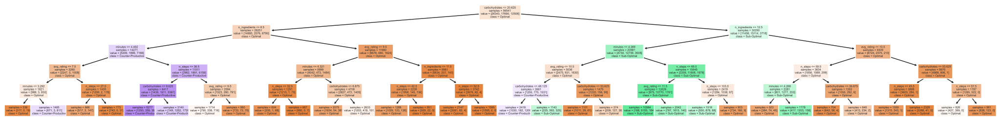

In [81]:
from sklearn.tree import plot_tree
plt.figure(figsize=(50, 6))
plot_tree(
    baseline_recipe_classifier.named_steps['decisiontreeclassifier'],
    feature_names=X_train.columns,
    class_names=['Optimal', 'Sub-Optimal', 'Counter-Productive'],
    filled=True,
    fontsize=8,
    impurity=False
);

### Baseline Classifier Evaluation

In [82]:
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay

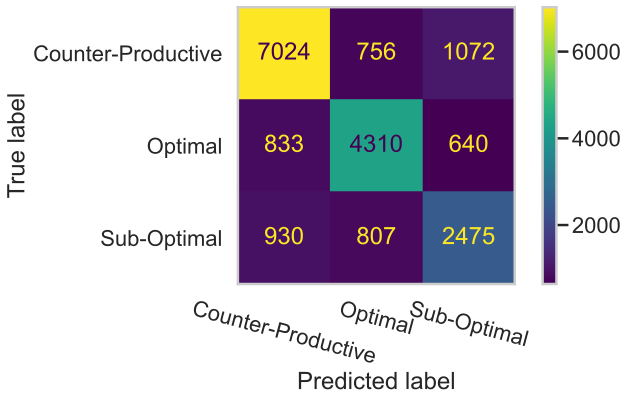

In [83]:
ConfusionMatrixDisplay.from_estimator(baseline_recipe_classifier, X_test, y_test, xticks_rotation=345);
plt.grid(False);

In [84]:
y_test_pred = baseline_recipe_classifier.predict(X_test)
y_train_pred = baseline_recipe_classifier.predict(X_train)

In [85]:
# Training Accuracy
metrics.accuracy_score(y_train, y_train_pred)

0.7404184574025928

In [86]:
# Test Accuracy
metrics.accuracy_score(y_test, y_test_pred)

0.7326895527139597

### Precision By Class

In [87]:
bl_precision = (metrics.precision_score(
    y_test,
    y_test_pred,
    labels=['Optimal', 'Sub-Optimal', 'Counter-Productive'],
    average=None
))
print(f'Precision of Optimal: {bl_precision[0]}')
print(f'Precision of Sub-Optimal: {bl_precision[1]}')
print(f'Precision of Counter-Productive: {bl_precision[2]}')

Precision of Optimal: 0.7338668482887791
Precision of Sub-Optimal: 0.5911153570575591
Precision of Counter-Productive: 0.7993626948901786


Here, we are looking at **precision of Optimal** as our model evaluation metric: **~0.75** (Will be different with every new training/test split and pl.fit)

### Recall By Class

In [88]:
bl_recall = (metrics.recall_score(
    y_test,
    y_test_pred,
    labels=['Optimal', 'Sub-Optimal', 'Counter-Productive'],
    average=None
))
print(f'Recall of Optimal: {bl_recall[0]}')
print(f'Recall of Sub-Optimal: {bl_recall[1]}')
print(f'Recall of Counter-Productive: {bl_recall[2]}')

Recall of Optimal: 0.7452879128480028
Recall of Sub-Optimal: 0.5876068376068376
Recall of Counter-Productive: 0.7934929959331225


Here, we are looking at **recall of Counter-Productive** as our model evaluation metric: **~0.83** (Will be different with every new training/test split and pl.fit)

### Baseline Classifier Evaluation Report
I do not believe that my current model is good.

<ul>
    <li>
        First, it has a low test accuracy of <b>~0.74</b>.
    </li>
    <li>
        Second, the evaluation metrics that I am using for my model, <b>precision of Optimal</b> and <b>recall of
        Counter-Productive</b> are not favorable.
        <ul>
            <li>
                In fact, the <b>precision of <code>Optimal</code></b> is lower than the <b>precision of
                <code>Counter-Productive</code></b>. This means that that my current model is minimizing the cases
                that a predicted <code>Counter-Productive</code> recipe is not actually 
                <code>Counter-Productive</code>. We do not care about that as college students will likely not try
                to make a <code>Counter-Productive</code> recipe. We want to minimize the cases that a predicted
                <code>Optimal</code> recipe is not actually <code>Optimal</code>.
            </li>
            <li>
                Fortunately, the <b>recall of <code>Counter-Productive</code></b> is higher than the <b>recall of
                <code>Optimal</code></b>. This means that that my current model is minimizing the cases where a
                actual <code>Counter-Productive</code> recipe is being predicted otherwise. We care about
                minimizing this case as we don't want college students making a recipe that is predicted as
                <code>Optimal</code> or <code>Sub-Optimal</code> but ending up wasting their time on a
                <code>Counter-Productive</code> recipe. I still want to increase this metric as much as possible.
            </li>
        </ul>
    </li>
</ul>

I want to increase both **precision of Optimal** and **recall of Counter-Productive** significantly in my final model. While also maintaining model generalization with low bias and low variance by tuning hyperparameters.

## Step 7: Final Model

In order to improve my previous model I will be using the same training/test split as above. In my final model, I will be engineering two new features by transforming multiple columns into new features. I will also be using a RandomForestClassifier instead of a DecisionTreeClassifier. I will be using cross-validation to tune my hyperparameters: tree_depth and criterion. My model evaluation metrics will stay the same.

In [89]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

In [90]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import FunctionTransformer

In [91]:
DV

{'total fat': 78,
 'sugar': 50,
 'sodium': 2.3,
 'protein': 50,
 'saturated fat': 20,
 'carbohydrates': 275}

In [92]:
usda_rec

{'protein': 0.12406947890818859,
 'total fat': 0.1935483870967742,
 'carbohydrates': 0.6823821339950372}

In [94]:
def sum_diffs_USDA_portions(x):
    portions=x[['protein', 'total fat', 'carbohydrates']].copy()
    total=portions.apply(sum, axis=1)
    for col in portions.columns:
        portions[col] = portions[col]/total
        
    for col in portions.columns:
        portions[col] = portions[col].apply(lambda x: abs(x - usda_rec[col]) if not pd.isna(x) else usda_rec[col])
    
    x['total_discrepancies_from_USDA'] = portions.sum(axis=1)
    
    return x

def make_composite(x):
    standard=pd.DataFrame(StandardScaler().fit_transform(x))
    x[f'composite_{"_".join(x.columns)}'] = standard.sum(axis=1).to_numpy()
    
    return x
    
preprocessor = make_column_transformer(
    (SimpleImputer(strategy='mean'), ['avg_rating']),
    (FunctionTransformer(sum_diffs_USDA_portions), ['protein', 'total fat', 'carbohydrates']),
    (FunctionTransformer(make_composite), ['minutes', 'n_steps', 'n_ingredients']),
    remainder='passthrough'
)

optimize_recipes = make_pipeline(
    preprocessor,
    RandomForestClassifier(
        max_depth=3,
        n_estimators=100
    )
)

In [95]:
optimize_recipes

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('simpleimputer',
                                                  SimpleImputer(),
                                                  ['avg_rating']),
                                                 ('functiontransformer-1',
                                                  FunctionTransformer(func=<function sum_diffs_USDA_portions at 0x106e8baf0>),
                                                  ['protein', 'total fat',
                                                   'carbohydrates']),
                                                 ('functiontransformer-2',
                                                  FunctionTransformer(func=<function make_composite at 0x2bec36670>),
                                                  ['minutes', 'n_steps',
                                                   'n_ingredients'])])),
               

In [96]:
from sklearn.model_selection import GridSearchCV

In [97]:
hyperparameters = {
    'randomforestclassifier__max_depth': np.arange(1, 50, 5),
    'randomforestclassifier__criterion': ['entropy', 'gini']
}

In [98]:
grids = GridSearchCV(
    optimize_recipes,
    n_jobs=-1,
    param_grid=hyperparameters,
    return_train_score=True
)
grids.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('columntransformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('simpleimputer',
                                                                         SimpleImputer(),
                                                                         ['avg_rating']),
                                                                        ('functiontransformer-1',
                                                                         FunctionTransformer(func=<function sum_diffs_USDA_portions at 0x106e8baf0>),
                                                                         ['protein',
                                                                          'total '
                                                                          'fat',
                                                                          'carbohydrates'

In [99]:
grids.best_params_

{'randomforestclassifier__criterion': 'entropy',
 'randomforestclassifier__max_depth': 46}

In [100]:
grids.score(X_train, y_train)

1.0

In [101]:
grids.score(X_test, y_test)

0.968376930015387

In [102]:
y_test_pred = grids.predict(X_test)
metrics.accuracy_score(y_test, y_test_pred)

0.968376930015387

In [103]:
final_precision = (metrics.precision_score(
    y_test,
    y_test_pred,
    labels=['Optimal', 'Sub-Optimal', 'Counter-Productive'],
    average=None
))
print(f'Precision of Optimal: {final_precision[0]}')
print(f'Precision of Sub-Optimal: {final_precision[1]}')
print(f'Precision of Counter-Productive: {final_precision[2]}')

Precision of Optimal: 0.9688857987137146
Precision of Sub-Optimal: 0.9515899383009018
Precision of Counter-Productive: 0.9760135135135135


In [104]:
final_recall = (metrics.recall_score(
    y_test,
    y_test_pred,
    labels=['Optimal', 'Sub-Optimal', 'Counter-Productive'],
    average=None
))
print(f'Recall of Optimal: {final_recall[0]}')
print(f'Recall of Sub-Optimal: {final_recall[1]}')
print(f'Recall of Counter-Productive: {final_recall[2]}')

Recall of Optimal: 0.963859588448902
Recall of Sub-Optimal: 0.9520417853751187
Recall of Counter-Productive: 0.9791007681879801


## Step 8: Fairness Analysis

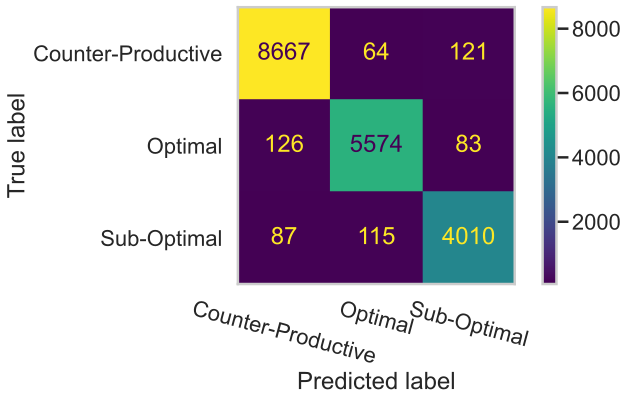

In [105]:
ConfusionMatrixDisplay.from_estimator(grids, X_test, y_test, xticks_rotation=345);
plt.grid(False)

In [104]:
X_test['avg_rating'].apply(lambda x: round(x) if pd.notna(x) else np.nan)

41281     5.0
183072    5.0
35883     5.0
198810    5.0
3326      5.0
         ... 
197180    4.0
172433    5.0
202291    5.0
109243    5.0
39827     5.0
Name: avg_rating, Length: 18847, dtype: float64

In [105]:
results = X_test
results['avg_rating'] = results['avg_rating'].apply(lambda x: round(x) if pd.notna(x) else np.nan)
results['prediction'] = y_test_pred
results['tag'] = y_test

(
    results
    .groupby('avg_rating')
    .apply(lambda x: 1 - metrics.recall_score(x['tag'], x['prediction'], labels=['Sub-Optimal', 'Counter-Productive'], average=None))
    .plot(kind='bar', title='False Negative Rate by Avg_Rating')
)

/Users/silver/miniforge3/envs/dsc80/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

